<a href="https://colab.research.google.com/github/durgavutla/ANN_Classify-the-Images-of-Clothes/blob/main/House_Price_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing the Libraries

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
%matplotlib inline
sns.set(rc={'figure.figsize': (24,8), 'figure.dpi':500})

# Loading the Dataset

In [ ]:
df = pd.read_csv("/content/train.csv")

# Data Overview

In [ ]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.00000,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.00000,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.00000,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.00000,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.00000,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.00000,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.00000,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.00000,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.00000,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.00000,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.00000,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.00000,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.00000,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.00000,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.00000,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


Lets have a look on number of rows and columns in the dataset

In [ ]:
pd.DataFrame([df.shape], index=['#'], columns=['Rows', 'Columns'])

,Rows,Columns
#,1460,81


# Summary of Dataset

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [ ]:
corr_data=df.corr().drop('SalePrice').sort_values('SalePrice', ascending=False)[['SalePrice']]

In [ ]:
corr_data

,SalePrice
OverallQual,0.79098
GrLivArea,0.70862
GarageCars,0.64041
GarageArea,0.62343
TotalBsmtSF,0.61358
1stFlrSF,0.60585
FullBath,0.56066
TotRmsAbvGrd,0.53372
YearBuilt,0.52290
YearRemodAdd,0.50710


In [ ]:
pd.DataFrame([[df.isna().sum().sum()]], columns=['Dataset'], index=['Missing Values'])

,Dataset
Missing Values,6965


# To filter the Missing Count > 0

In [ ]:
def missing_percent(df):
  nan_percent=100*(df.isnull().sum().sort_values(ascending=False)/len(df))
  return nan_percent[nan_percent>0]

# Lets find out the Missing Values 

In [ ]:
temp=missing_percent(df)
pd.DataFrame({'Column_Name':temp.index, 'Missing_Percentage':temp.values}).style.background_gradient(cmap='Reds')

,Column_Name,Missing_Percentage
0,PoolQC,99.520548
1,MiscFeature,96.301370
2,Alley,93.767123
3,Fence,80.753425
4,FireplaceQu,47.260274
5,LotFrontage,17.739726
6,GarageCond,5.547945
7,GarageType,5.547945
8,GarageYrBlt,5.547945
9,GarageFinish,5.547945


# Data Visualization

Distribution of Target Varibale (Sale Price)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


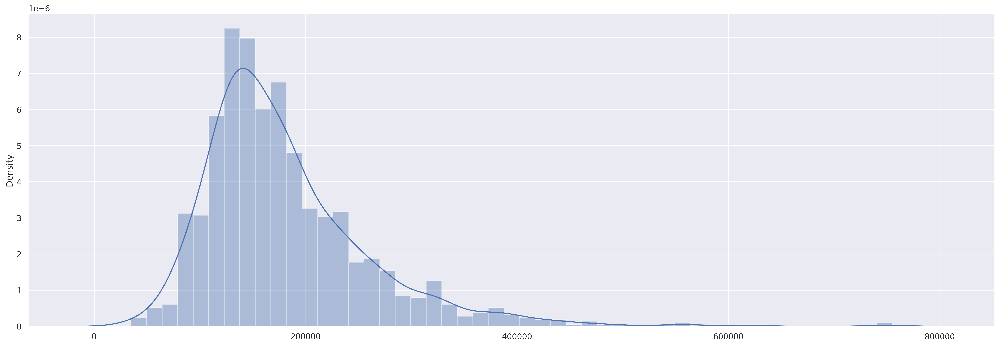

In [ ]:
sns.distplot(df[['SalePrice']])
plt.show()

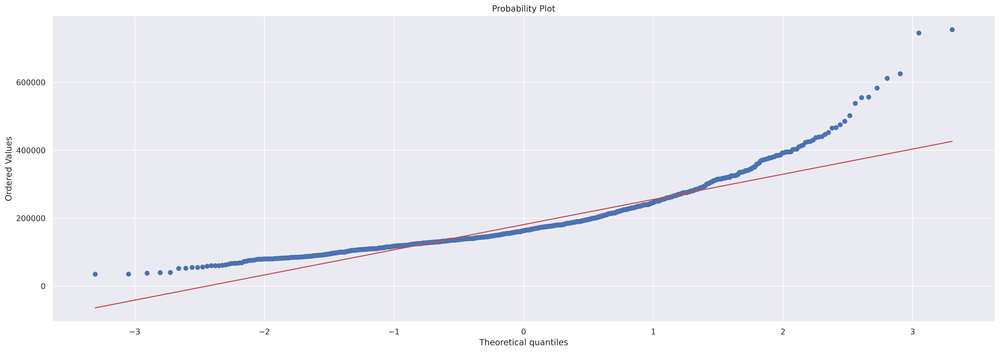

In [ ]:
res = stats.probplot(df['SalePrice'], plot=plt)
plt.show()

Most MAchine Learning algorithm works well with data which are normally distributed

The Target Variable (Sale Price) is Right Skewed. We need to transform this variable and make it into Normally Distribution.

Let's transform the target varibale by taking Log Scale

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


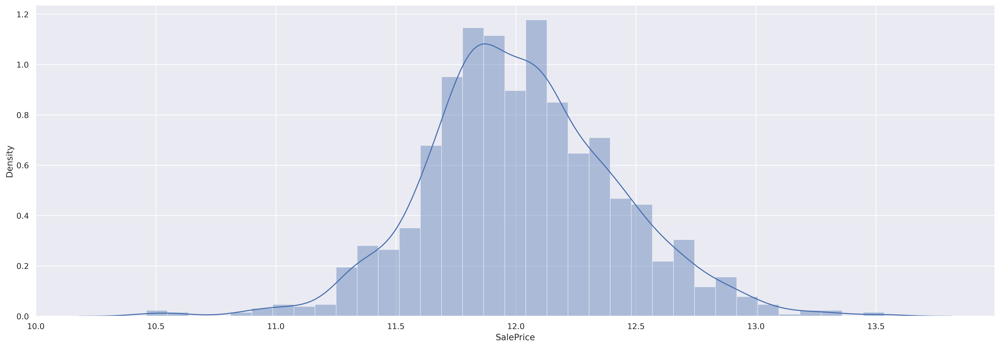

In [ ]:
df['SalePrice'] = np.log(df['SalePrice'])
sns.distplot(df['SalePrice'])
plt.show()

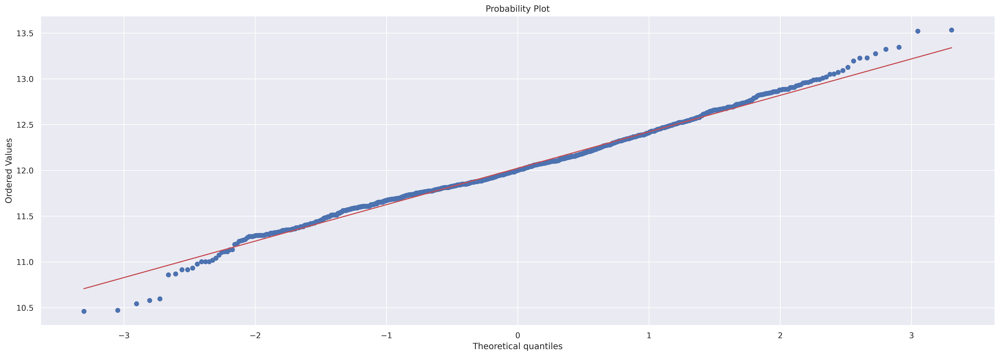

In [ ]:
stats.probplot(df['SalePrice'], plot=plt)
plt.show()

As we see above now the Sale Price is Normally Distributed

Let's find out Plotting Missing Values in Dataset

In [ ]:
def draw_barplot(data):
  bar_plot=sns.barplot(x=data.index, y=data)
  plt.xticks(rotation=45)
  bar_plot.bar_label(bar_plot.containers[0], fmt='%.2f')
  plt.show()

In [ ]:
nan_percent=missing_percent(df)

AttributeError: ignored

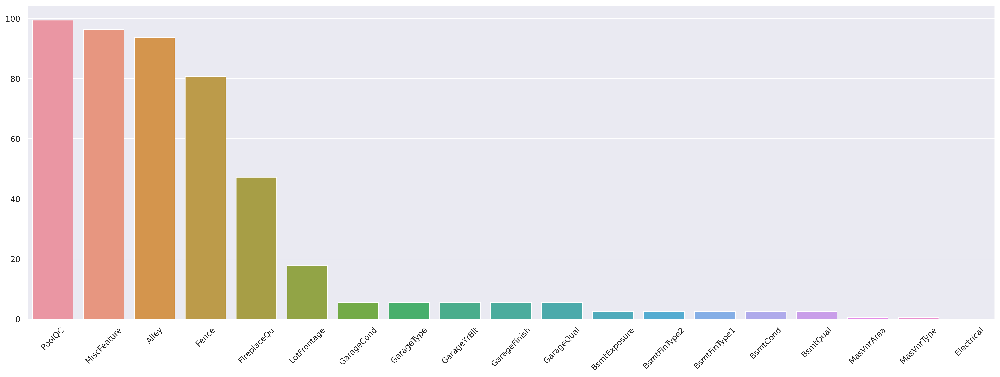

In [ ]:
draw_barplot(nan_percent)

Exploratory Data Analysis (EDA)

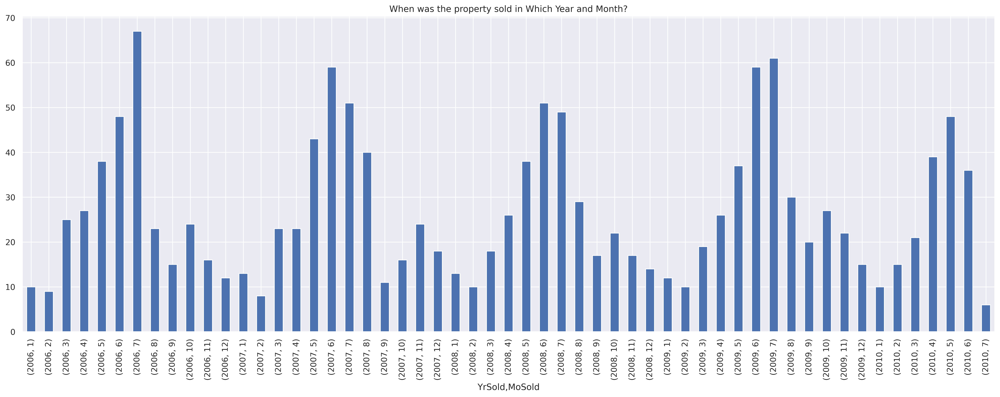

In [ ]:
df.groupby(['YrSold', 'MoSold']).Id.count().plot(kind='bar')
plt.title('When was the property sold in Which Year and Month?')
plt.show()

We can see, in June & July month the property sales are highest.

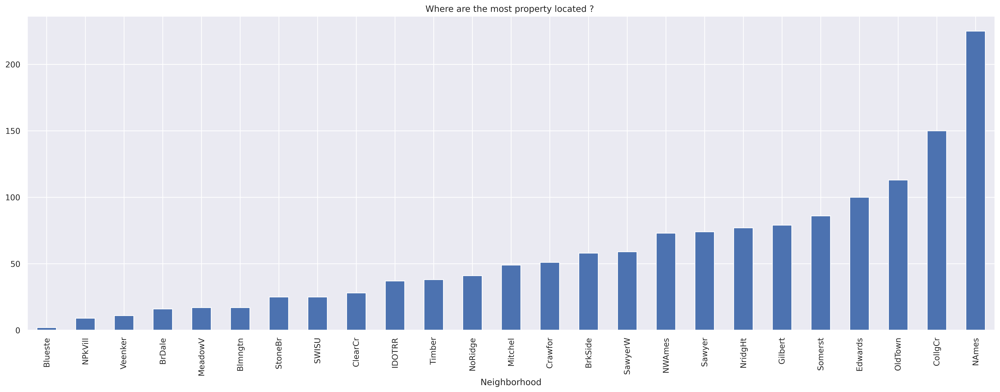

In [ ]:
df.groupby('Neighborhood').Id.count().sort_values().plot(kind='bar')
plt.title('Where are the most property located ? ')
plt.show()

In the above chart, CollgCr and NAmes are the highest Neighborhood location for the property.

# Data Preparation

In [ ]:
# Finding the Numerical Values
numeric_data=df.select_dtypes(include=[np.number]).drop(['SalePrice', 'Id'],axis=1)

# Finding the Categorical Values
categorical_data=df.select_dtypes(include='object')

In [ ]:
pd.DataFrame([[numeric_data.shape[1], categorical_data.shape[1]]], columns=['Numerical_Features', 'Categorical_Features'], index=['Count'])

,Numerical_Features,Categorical_Features
Count,36,43


In [ ]:
temp_numeric_data=pd.melt(df, value_vars=sorted(numeric_data))
temp_numeric_data

,variable,value
0,1stFlrSF,856.00000
1,1stFlrSF,1262.00000
2,1stFlrSF,920.00000
3,1stFlrSF,961.00000
4,1stFlrSF,1145.00000
...,...,...
52555,YrSold,2007.00000
52556,YrSold,2010.00000
52557,YrSold,2010.00000
52558,YrSold,2010.00000


In [ ]:
facet_grid=sns.FacetGrid(temp_numeric_data, col='variable', col_wrap=3,sharex=False,sharey=False)
facet_grid.map(sns.distplot,'value')
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function 

Transforming the some Numerical Variables that are really Categorical

We can see that some of the features having Int Data types consists of Discrete Values.

If the features are into Discrete Variable/ Values, It's better to change them into Categorical Varibales that will help us for "Good Anlaysis"

In [ ]:
# Will convert those columns into Dummy variables

int_to_object = ['MSSubClass', 'YrSold', 'MoSold', 'OverallCond']

for feature in int_to_object:
    df[feature] = df[feature].astype(object)

Let's Plot the Categorical Features

In [ ]:
# Finding the Numerical Features
numeric_data=df.select_dtypes(include=[np.number]).drop(['SalePrice', 'Id'], axis=1)

# Finding the Categorical Features
categorical_data=df.select_dtypes(include='object')

In [ ]:
pd.DataFrame([[numeric_data.shape[1], categorical_data.shape[1]]], columns=['Numerical Features', 'Categorical Features'], index=['Count'])

,Numerical Features,Categorical Features
Count,32,47


In [ ]:
temp_categorical_data=pd.melt(df, value_vars=sorted(categorical_data))

In [ ]:
facet_grid=sns.FacetGrid(temp_categorical_data,col='variable',col_wrap=3, sharex=False, sharey=False, height=3, aspect=2)
facet_grid.map(sns.countplot, 'value')
[plt.setp(ax.get_xticklabels(), rotation=60, ha='right')
for ax in facet_grid.axes.flat]
facet_grid.fig.tight_layout()
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:643: UserWarning: Using the countplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


# Outliers

In [ ]:
def draw_corr_plot(df):
    data=df.corr().drop('SalePrice').sort_values('SalePrice', ascending=False)[['SalePrice']]
    charts=sns.barplot(data.index,data['SalePrice'], palette='Blues_d')
    plt.xticks(rotation=90)
    plt.title('Correlation with Sale Price')
    chart.bar_label(chart.containers[0], fmt='%.3f')
    plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


NameError: ignored

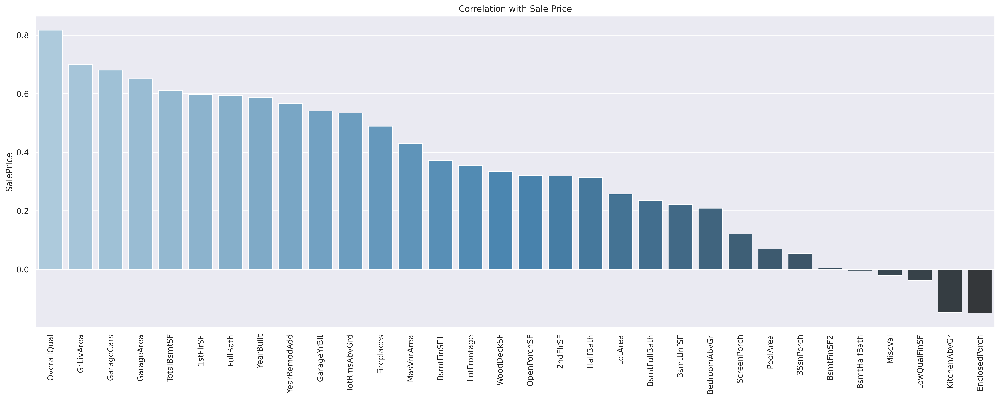

In [ ]:
draw_corr_plot(df)

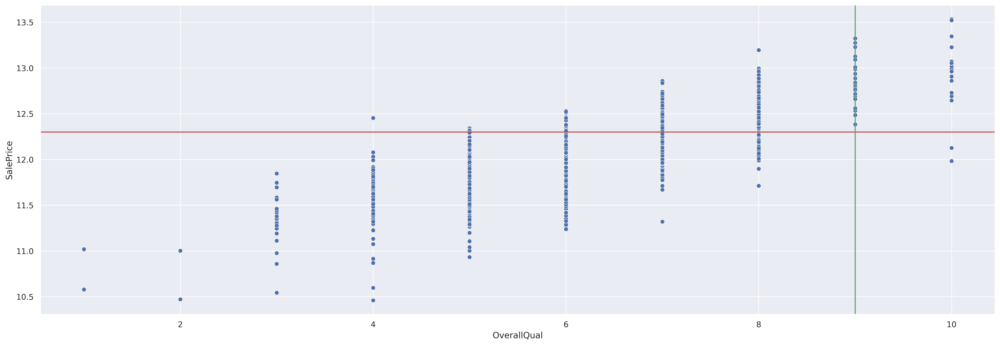

In [ ]:
sns.scatterplot(data=df, x='OverallQual', y='SalePrice')
plt.axhline(y=12.3, color='r')
plt.axvline(x=9, color='g')

In [ ]:
df[(df['OverallQual']>9) & (df['SalePrice']<12.3)][['SalePrice', 'OverallQual']]

,SalePrice,OverallQual
523,12.12676,10
1298,11.98293,10


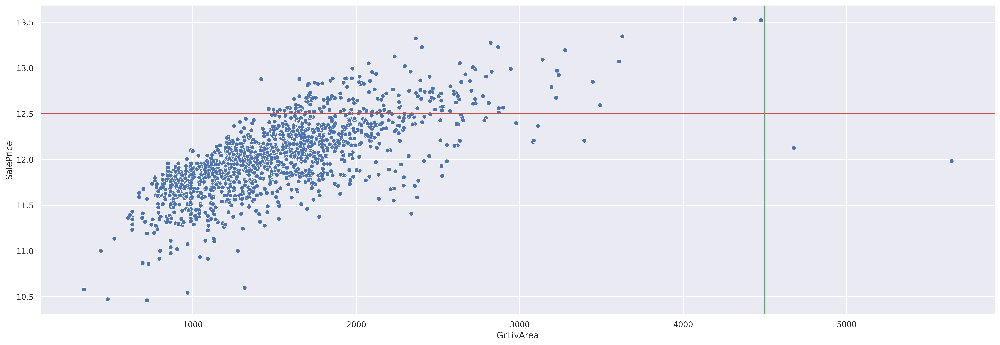

In [ ]:
sns.scatterplot(data=df, x='GrLivArea', y='SalePrice')
plt.axhline(y=12.5, color='r')
plt.axvline(x=4500, color='g')

In [ ]:
df[(df['GrLivArea']>4500) & (df['SalePrice']<12.5)][['SalePrice', 'GrLivArea']]

,SalePrice,GrLivArea
523,12.12676,4676
1298,11.98293,5642


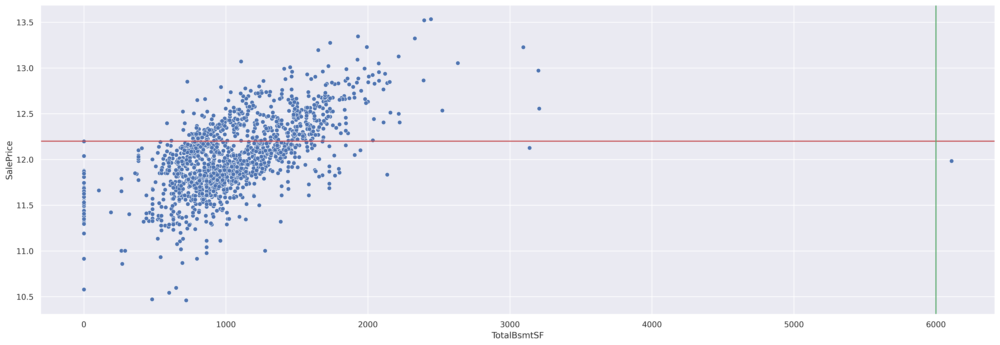

In [ ]:
sns.scatterplot(data=df, x='TotalBsmtSF', y='SalePrice')
plt.axhline(y=12.2, color='r')
plt.axvline(x=6000, color='g')

In [ ]:
df[(df['TotalBsmtSF']>6000) & (df['SalePrice']<12.2)][['SalePrice', 'TotalBsmtSF']]

,SalePrice,TotalBsmtSF
1298,11.98293,6110


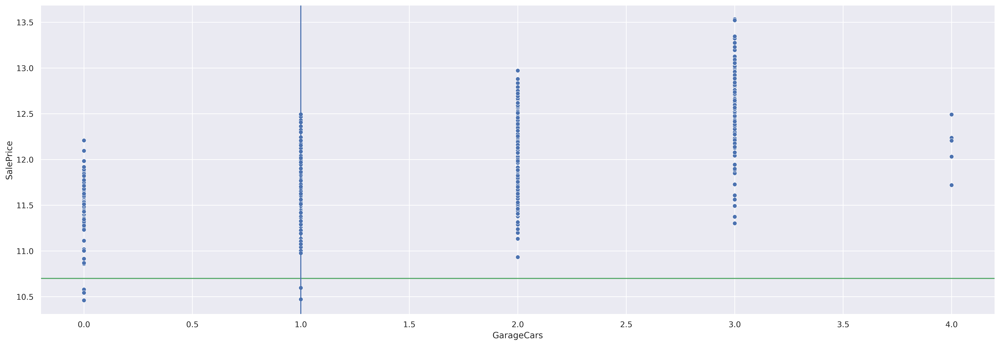

In [ ]:
sns.scatterplot(data=df, x='GarageCars', y='SalePrice')
plt.axhline(y=10.7, color='g')
plt.axvline(x=1, color='b')

In [ ]:
df[(df['GarageCars']==1) & (df['SalePrice']<10.7)][['SalePrice', 'GarageCars']]

,SalePrice,GarageCars
30,10.59663,1
916,10.47195,1


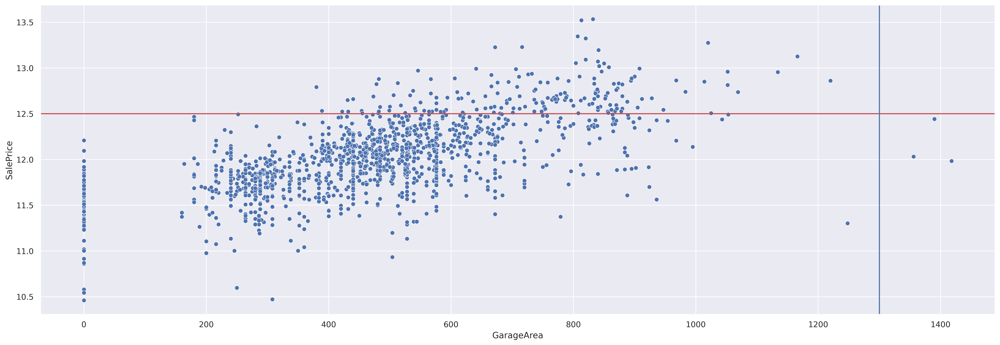

In [ ]:
sns.scatterplot(data=df, x='GarageArea', y='SalePrice')
plt.axhline(y=12.5, color='r')
plt.axvline(x=1300, color='b')

In [ ]:
df[(df['GarageArea']>1300) & (df['SalePrice']<12.5)][['SalePrice', 'GarageArea']]

,SalePrice,GarageArea
581,12.44230,1390
1190,12.03172,1356
1298,11.98293,1418


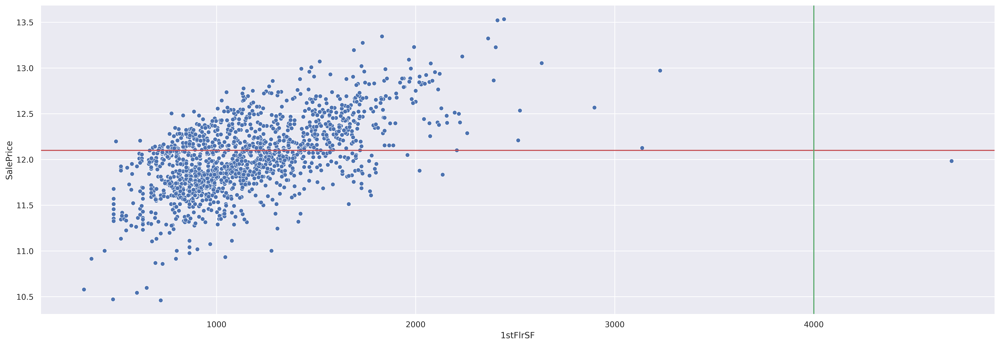

In [ ]:
sns.scatterplot(data=df, x='1stFlrSF', y='SalePrice')
plt.axhline(y=12.1, color='r')
plt.axvline(x=4000, color='g')

In [ ]:
df[(df['1stFlrSF']>4000) & (df['SalePrice']<12.1)][['SalePrice','1stFlrSF']]

,SalePrice,1stFlrSF
1298,11.98293,4692


There are Outliers in some features

Deleting those four values with Outliers (30, 523, 581, 916, 1190, 1298)

In [ ]:
# Remove 30, 916, 523, 1190, 1298, 581
df=df.drop([30, 916, 523, 1190, 1298, 581])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


NameError: ignored

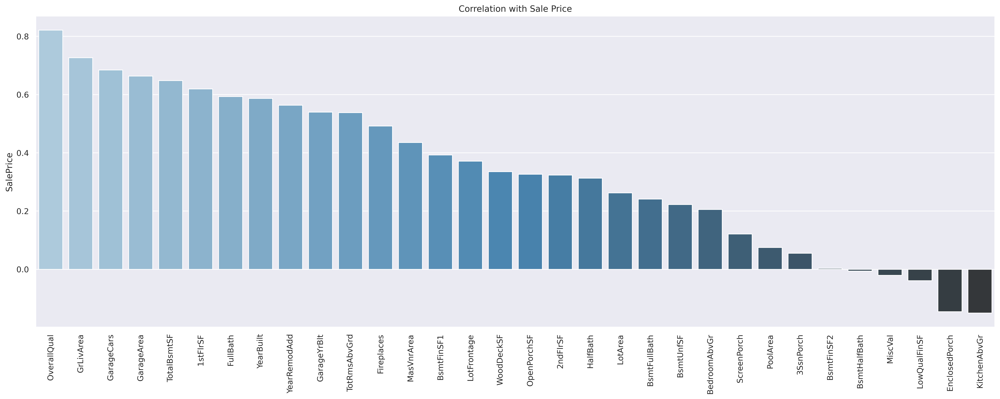

In [ ]:
draw_corr_plot(df)

We can see on above graph that Correlation between our data has improved

Visualising Missing Values

In [ ]:
print(f'There are {df.isnull().sum().sum()} missing values')

There are 6941 missing values


Plot the feature with Missing indicating the Percent of Missing Data

In [ ]:
missing_percent(df)

PoolQC         99.58735
MiscFeature    96.28611
Alley          93.81018
Fence          80.74278
FireplaceQu    47.31774
LotFrontage    17.74415
GarageType      5.57084
GarageCond      5.57084
GarageFinish    5.57084
GarageQual      5.57084
GarageYrBlt     5.57084
BsmtFinType2    2.61348
BsmtExposure    2.61348
BsmtQual        2.54470
BsmtCond        2.54470
BsmtFinType1    2.54470
MasVnrArea      0.55021
MasVnrType      0.55021
Electrical      0.06878
dtype: float64

In [ ]:
def draw_missing_barplot(df,ylim_min=None,ylim_max=None):
        nan_percent= missing_percent(df).sort_values(ascending=True)
        bar_plot=sns.barplot(x=nan_percent.index,y=nan_percent)
        plt.xticks(rotation=60)
        bar_plot.bar_label(bar_plot.containers[0],fmt='%.3f')
        if ylim_min!= None and ylim_max!= None:
            plt.ylim(ylim_min,ylim_max)
        plt.show()

AttributeError: ignored

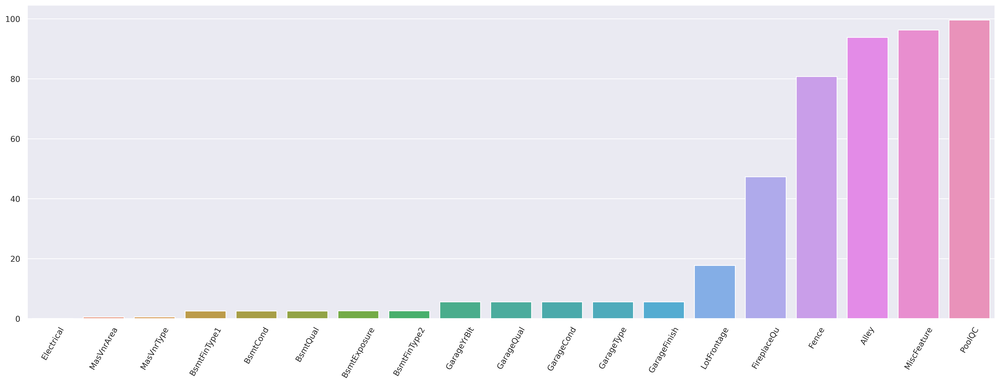

In [ ]:
draw_missing_barplot(df,0,1)

In [ ]:
100/len(df)

0.0687757909215956

# Electrical

In [ ]:
df[df['Electrical'].isnull()]

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1379,80,RL,73.00000,9735,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,SLvl,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,None,0.00000,TA,TA,PConc,Gd,TA,No,Unf,0,Unf,0,384,384,GasA,Gd,Y,NaN,754,640,0,1394,0,0,2,1,3,1,Gd,7,Typ,0,NaN,BuiltIn,2007.00000,Fin,2,400,TA,TA,Y,100,0,0,0,0,0,NaN,NaN,NaN,0,5,2008,WD,Normal,12.02874


# Electrical : Fill in again with Most Frequent which is "SBrkr"

In [ ]:
df['Electrical'] = df['Electrical'].fillna(df['Electrical'].mode()[0])

# MasVnrArea, MasVnrType

NA most likely means no masonry veneer  for thses houses. We can fill 0 for the area and None for the type

In [ ]:
df['MasVnrArea'] = df['MasVnrArea'].fillna(0)
df['MasVnrType'] = df['MasVnrType'].fillna("None")

AttributeError: ignored

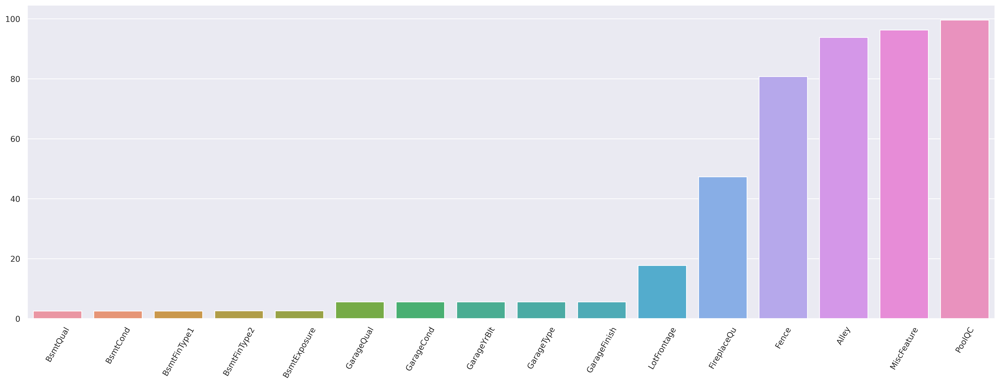

In [ ]:
draw_missing_barplot(df,0,20)

# BsmtQual, BsmtCond, BsmtExposure, BsmtFinType1, BsmtFinType2

Nan values for these categorical basement df, means there's no Basement

In [ ]:
for col in ('BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2'):
    # Replacing the Missing Values
    df[col] = df[col].fillna('None')

AttributeError: ignored

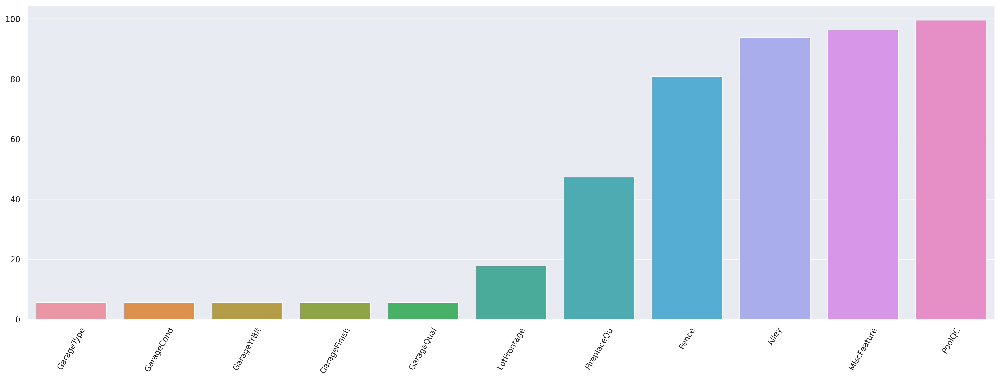

In [ ]:
draw_missing_barplot(df,0,20)

GarageYrBlt

# Replacing Missing Values with 0

In [ ]:
df['GarageYrBlt'] = df['GarageYrBlt'].fillna(0)

# GarageType, GarageFinish, GarageQual, GarageCond

# Replacing Missing Data with None

In [ ]:
for col in ['GarageType', 'GarageFinish', 'GarageQual', 'GarageCond']:
    df[col] = df[col].fillna('None')

AttributeError: ignored

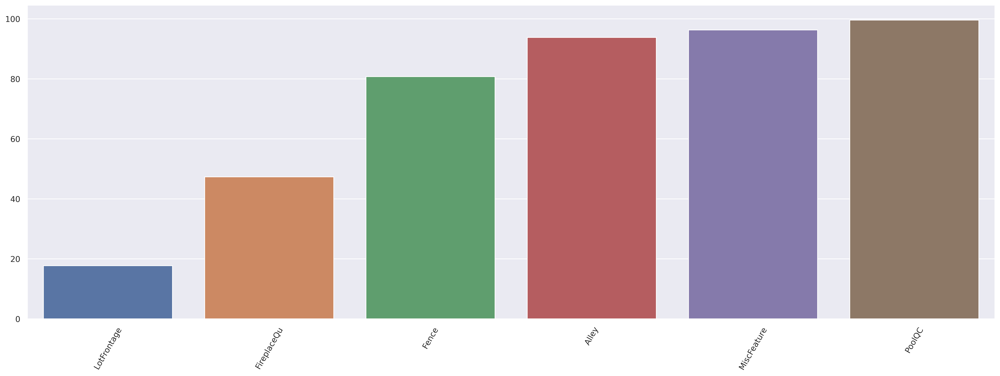

In [ ]:
draw_missing_barplot(df)

# LotFrontage

Since the area of each street connected to the house property most likely have a similar area to other houses in its neighborhood.

We can fill  in Missing Values by the Mean LotFrontage of the Neighborhood

In [ ]:
df['LotFrontage'] = df.groupby("Neighborhood")['LotFrontage'].apply(lambda x: x.fillna(x.mean()))

# FirePlace Qu

Data Description says NA means "No Fireplace"

In [ ]:
df['FireplaceQu'] = df['FireplaceQu'].fillna('None')

# Fence

Data Description says NA means "No Alley Access"

In [ ]:
df['Alley'] = df['Alley'].fillna('None')

# MiscFeature

Data Description says NA means "NO Misc Feature"

In [ ]:
df['MiscFeature'] = df['MiscFeature'].fillna('None')

# PoolQC

Data Description says No means "NO Pool"

In [ ]:
df['PoolQC'] = df['PoolQC'].fillna('None')

# It shows there are No Missing Values anymore

In [ ]:
df.isnull().sum().sum()

1174

In [ ]:
df.to_csv('clean_df.csv', encoding='utf-8', index=False)

Getting Dummy Categorical Features

In [ ]:
df_num=df.select_dtypes(exclude='object')
df_obj=df.select_dtypes(include='object')

In [ ]:
# use one-hot encoding
df_obj=pd.get_dummies(df_obj, drop_first=True)

In [ ]:
Final_df= pd.concat([df_num, df_obj], axis=1)

# Linear Regression


Determine the Features and Target Variable

In [ ]:
X = Final_df.drop('SalePrice', axis=1)
y = Final_df['SalePrice']

Split the Dataset into Train & Test

In [ ]:
from sklearn.model_selection import train_test_split
X_train_linear, X_test_linear, y_train_linear, y_test_linear= train_test_split(X, y, test_size=0.3, random_state=101)

# Train the Model

In [ ]:
from sklearn.linear_model import LinearRegression

In [ ]:
linear_model=LinearRegression()

In [ ]:
linear_model.fit(X_train_linear, y_train_linear)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

# Predicting the Test Data

In [ ]:
y_pred_linear=linear_model.predict(X_test_linear)

# Evaluate the Model

In [ ]:
from sklearn import metrics

In [ ]:
MAE_linear=metrics.mean_absolute_error(y_test_linear, y_pred_linear)
MSE_linear=metrics.mean_squared_error(y_test_linear, y_pred_linear)
RMSE_linear=np.sqrt(MSE_linear)

In [ ]:
metrics_linear=pd.DataFrame([MAE_linear, MSE_linear, RMSE_linear], index=['MAE', 'MSE', 'RMSE'], columns=['Metrics of Linear'])

In [ ]:
metrics_linear

,Metrics of Linear
MAE,0.08394
MSE,0.01388
RMSE,0.11781


# Residuals

In [ ]:
residuals_linear=y_test_linear-y_pred_linear

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


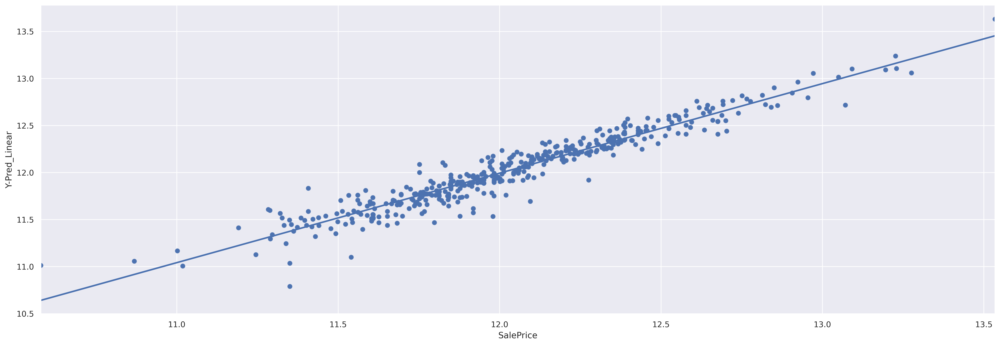

In [ ]:
sns.scatterplot(x=y_test_linear, y=y_pred_linear)
plt.ylabel('Y-Pred_Linear')
plt.xlabel('Y-Test_Linear')
sns.regplot(y_test_linear, y_pred_linear, ci=None)
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


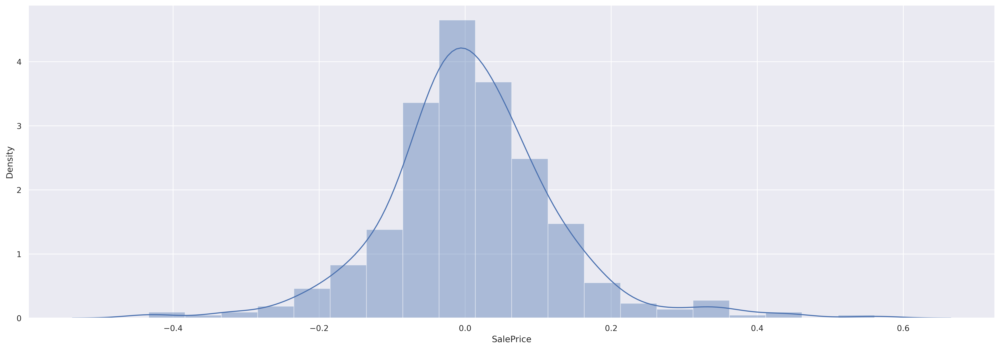

In [ ]:
sns.distplot(residuals_linear, bins=20, kde=True)
plt.show()

# Residuals is normally Distributed

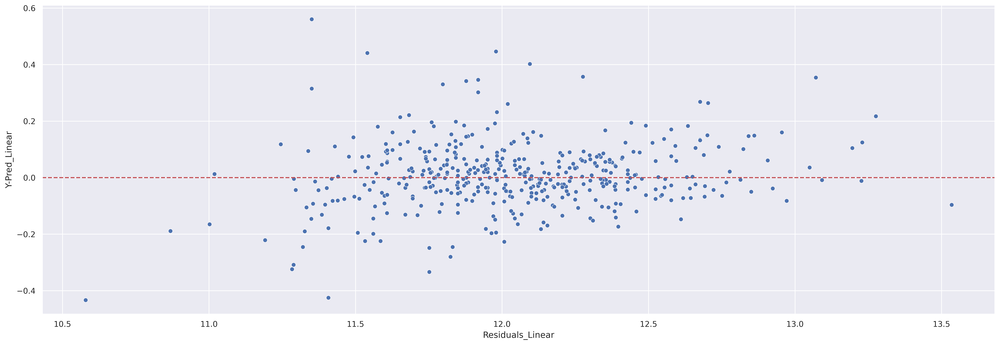

In [ ]:
sns.scatterplot(x=y_test_linear, y=residuals_linear)
plt.ylabel('Y-Pred_Linear')
plt.xlabel('Residuals_Linear')
plt.axhline(y=0, color='r', ls='--')
plt.show()

# Polynomial Regression

Pre-Processing

In [ ]:
from sklearn.preprocessing import PolynomialFeatures

In [ ]:
polynomial_coverter=PolynomialFeatures(degree=2, include_bias=False)

In [ ]:
polynomial_features=polynomial_coverter.fit_transform(X)

Spilting the dataset into Train & Test

In [ ]:
from sklearn.model_selection import train_test_split
X_train_poly, X_test_poly, y_train_poly, y_test_poly = train_test_split(polynomial_features, y, test_size=0.3, random_state=101)

# Train the Model

In [ ]:
poly_model = LinearRegression()

In [ ]:
poly_model.fit(X_train_poly, y_train_poly)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

# Predicting Test Data

In [ ]:
y_pred_poly = poly_model.predict(X_test_poly)

# Evaluate the Model

In [ ]:
MAE_poly=metrics.mean_absolute_error(y_test_poly, y_pred_poly)
MSE_poly=metrics.mean_squared_error(y_test_poly, y_pred_poly)
RMSE_poly=np.sqrt(MSE_poly)

In [ ]:
metrics_poly=pd.DataFrame([MAE_poly, MSE_poly, RMSE_poly], index=['MAE', 'MSE', 'RMSE'], columns=['Metrics of Polynomial'])

In [ ]:
metrics_df=pd.concat([metrics_linear, metrics_poly], axis=1).T

In [ ]:
metrics_df

,MAE,MSE,RMSE
Metrics of Linear,0.08394,0.01388,0.11781
Metrics of Polynomial,0.24124,0.23404,0.48378


As per the analysis Linear Regression is the better from the Polynomial Regression Method in this Model